# Advanced plotting

So far, we've mostly worked with plots that are quick to analyze and make sense of. Line charts, scatter plots, and bar plots allow us to convey a few nuggets of insights to the reader. We've also explored how we can combine those plots in interesting ways to convey deeper insights and continue to extend the storytelling power of data visualization. In this mission, we'll explore how to quickly create plots that are suitable to statistical analysis and how to implement interactive plots with tools such as brushing, filtering, zoom, and hover.

There are several libraries to pruduce amazing plots, like:

- Seaborn
- Bokeh
- Plotly
- Dash
- Folium
- Matplotlib
- ggplot
- Pygal
- Geoplotlib
- missingno

We'll focus in the first three: [Seaborn](https://seaborn.pydata.org/), [Bokeh](https://bokeh.pydata.org/en/latest/) and [Plotly](https://plot.ly/python/)

To get things started, we have to load Pandas and NumPy libraries:

In [0]:
import pandas as pd
import numpy as np

## Loading the dataset

As we did in the previous mission, let's download the data directly from  [Dados Abertos Natal](http://dados.natal.br/) to our workspace in Google Colab.

In [2]:
!wget -c https://raw.githubusercontent.com/aguinaldoabbj/minicourse_open_data_natal_2019/master/data/dados-be-2018-analitico.csv
#wget -c http://dados.natal.br/dataset/4fad551d-4d3b-4597-b8d3-7e887e22332e/resource/0d4a0f0f-b8a5-46a0-acfe-bb9138c8eb9e/download/dados-be-2019-analitico.csv

--2019-03-23 06:19:58--  https://raw.githubusercontent.com/aguinaldoabbj/minicourse_open_data_natal_2019/master/data/dados-be-2018-analitico.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 72991 (71K) [text/plain]
Saving to: ‘dados-be-2018-analitico.csv’

dados-be-2018-anali 100%[===================>]  71.28K  --.-KB/s    in 0.02s   

2019-03-23 06:19:58 (2.85 MB/s) - ‘dados-be-2018-analitico.csv’ saved [72991/72991]



We can check if file was downloaded using 'ls':

In [0]:
!ls -lah  dados-be*

-rw-r--r-- 1 root root 72K Mar 23 06:06 dados-be-2018-analitico.csv


Now, we can read the CSV file:

In [0]:
# CSV file uses ';' as separator and is encodded in iso-8859-1
df = pd.read_csv("dados-be-2018-analitico.csv", encoding='iso-8859-1', sep=';', thousands=r'.')

Column "Linha" refers to the name of the bus line. Hence, it is plausible to convert the type of this column to string (str).

In [0]:
df['Linha'] = df['Linha'].astype(str)

In [0]:
df.head(10)

,Mês,Empresa,Linha,Estudante_Cartao,Estudante_BT,Vale_Transporte,Integracao_Plena,Integracao_Complementar,Gratuito_Cartao,Gratuito_BT,Inteira_Cartao,Inteira_Especie,Tarifa_Social,Qtd_Viagens
0,1,CONCEIÇÃO,21,13493,9506,35944,8671,0,17138,7397,6542,43727,3965,3684
1,1,CONCEIÇÃO,22,4644,3371,13088,3230,0,8109,3157,2529,15363,0,1737
2,1,CONCEIÇÃO,30,8519,5614,20580,5346,0,7265,3191,4415,21507,1537,2500
3,1,CONCEIÇÃO,31,9631,6020,23460,7587,0,7065,2922,5491,22212,140,2478
4,1,CONCEIÇÃO,41,6556,4038,20388,7924,0,5704,2791,3883,13870,0,2296
5,1,CONCEIÇÃO,59,8184,6086,22623,7332,0,13514,4373,4622,29075,4573,2650
6,1,CONCEIÇÃO,63,21918,14054,44118,14630,0,15034,5771,7765,39855,3182,3768
7,1,CONCEIÇÃO,71,7188,5395,19626,4209,0,10865,4075,3608,23923,3773,2389
8,1,CONCEIÇÃO,76,2886,1734,7298,1545,59,3494,1200,1507,8698,907,627
9,1,CONCEIÇÃO,83,4386,3932,14967,1194,0,3207,1125,2573,17649,2491,1284


# Storytelling from Seaborn

We'll be working with the [seaborn](http://seaborn.pydata.org/) visualization library, which is built on top of matplotlib. Seaborn has good support for more complex plots, attractive default styles, and integrates well with the pandas library. Here are some examples of some complex plots that can be created using seaborn:

<img width="800" alt="creating a repo" src="https://drive.google.com/uc?export=view&id=0BxhVm1REqwr0WS1ZUnpCeE1xTms">

**Seaborn** aims to make visualization a central part of exploring and understanding data. The plotting functions operate on dataframes and arrays containing a whole dataset and internally perform the necessary aggregation and statistical model-fitting to produce informative plots. If matplotlib “tries to make easy things easy and hard things possible”, seaborn tries to make a well-defined set of hard things easy too.

The plotting functions try to do something useful when called with a minimal set of arguments, and they expose a number of customizable options through additional parameters. Some of the functions plot directly into a matplotlib axes object, while others operate on an entire figure and produce plots with several panels. In the latter case, the plot is drawn using a Grid object that links the structure of the figure to the structure of the dataset.

Seaborn should be thought of as a complement to matplotlib, not a replacement for it. When using seaborn, it is likely that you will often invoke matplotlib functions directly to draw simpler plots already available through the pyplot namespace. Further, the seaborn functions aim to make plots that are reasonably “production ready” (including extracting semantic information from Pandas objects to add informative labels), but full customization will require changing attributes on the matplotlib objects directly. The combination of seaborn’s high-level interface and matplotlib’s customizability and wide range of backends makes it easy to generate publication-quality figures.

## Getting started

Firstly, let's upgrade the seaborn version to 0.9.0:

In [0]:
!pip install seaborn==0.9.0

Let's import the seaborn and matplotlib libraries and check if the upgrade occurred correctly.

In [0]:
import seaborn as sns
import matplotlib.pyplot as plt

In [0]:
sns.__version__

'0.9.0'

Now, let's set some configurations to get started:

In [0]:
#call seaborn default colors
sns.set()

# Contexts: paper, notebook, talk, and poster
sns.set_context("notebook")
# setting seaborn style sheet
sns.set(style="darkgrid")

## Line Plot

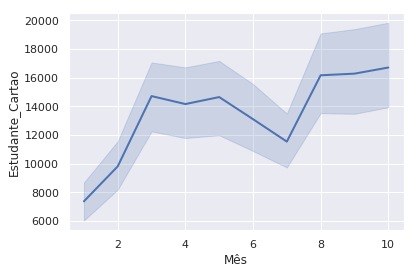

In [0]:
sns.lineplot(x="Mês", y="Estudante_Cartao", estimator=np.mean, data=df, linewidth=2.0)
plt.show()

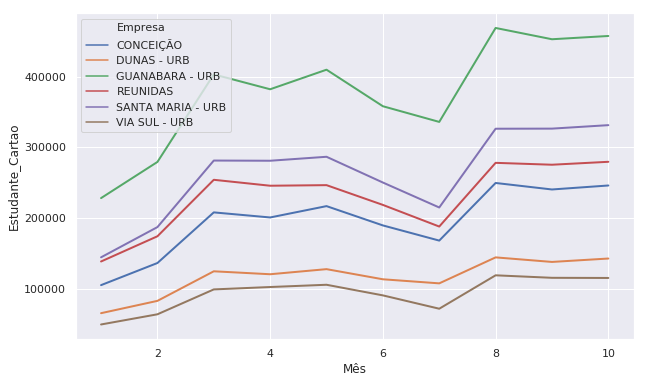

In [0]:
plt.figure(figsize=(10, 6))
sns.lineplot(x="Mês", y="Estudante_Cartao", hue="Empresa", data=df, estimator=sum, ci=None, linewidth=2.0)
plt.show()

## Bar Plot

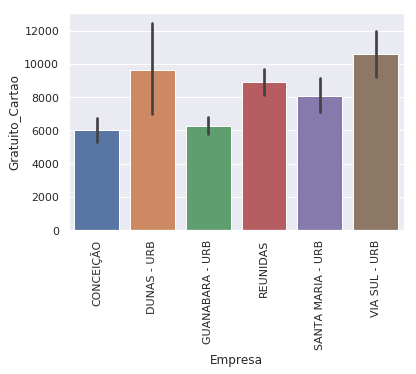

In [0]:
sns.barplot(x='Empresa', y='Gratuito_Cartao', data=df, estimator=np.mean)
plt.xticks(rotation=90)
plt.show()

In [0]:
df_melt = pd.melt(df, id_vars=['Empresa', 'Mês'], value_vars=['Gratuito_Cartao', 'Gratuito_BT'], var_name="Tipo de passagem", value_name="Nº de Passagens")
df_melt.head()

,Empresa,Mês,Tipo de passagem,Nº de Passagens
0,CONCEIÇÃO,1,Gratuito_Cartao,17138
1,CONCEIÇÃO,1,Gratuito_Cartao,8109
2,CONCEIÇÃO,1,Gratuito_Cartao,7265
3,CONCEIÇÃO,1,Gratuito_Cartao,7065
4,CONCEIÇÃO,1,Gratuito_Cartao,5704


In [0]:
df_melt.tail()

,Empresa,Mês,Tipo de passagem,Nº de Passagens
1893,SANTA MARIA - URB,10,Gratuito_BT,7
1894,VIA SUL - URB,10,Gratuito_BT,9226
1895,VIA SUL - URB,10,Gratuito_BT,7065
1896,VIA SUL - URB,10,Gratuito_BT,7764
1897,VIA SUL - URB,10,Gratuito_BT,2308


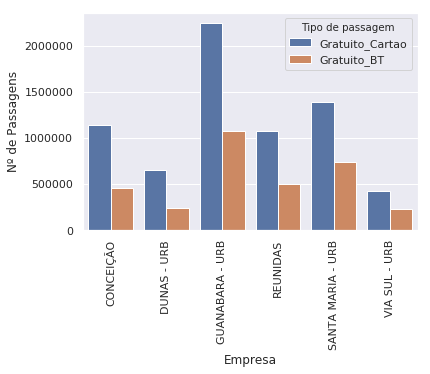

In [0]:
sns.barplot(x='Empresa', y="Nº de Passagens", hue="Tipo de passagem", data=df_melt, estimator=sum, ci=None)
plt.xticks(rotation=90)
plt.show()

## Point plot

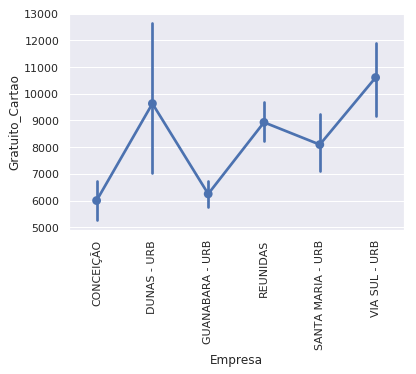

In [0]:
sns.pointplot(x='Empresa', y='Gratuito_Cartao', data=df)
plt.xticks(rotation=90)
plt.show()

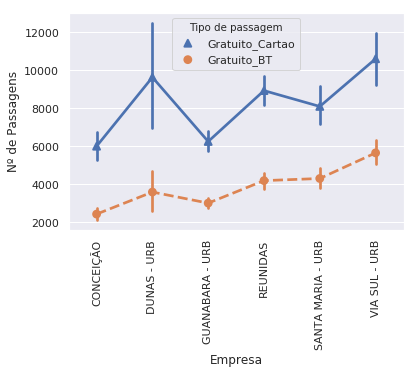

In [0]:
sns.pointplot(x='Empresa', y="Nº de Passagens", hue="Tipo de passagem", data=df_melt, markers=["^", "o"], linestyles=["-", "--"])
plt.xticks(rotation=90)
plt.show()

## Histogram and Kernel Density Estimates (KDE)

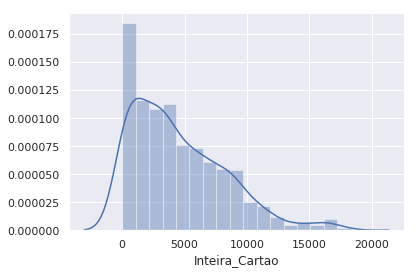

In [0]:
sns.distplot(df['Inteira_Cartao'])
plt.show()

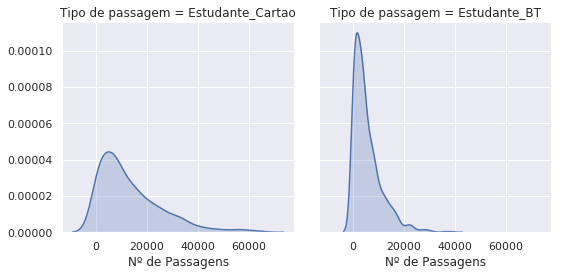

In [0]:
df_melt = pd.melt(df, id_vars=['Empresa', 'Mês'], value_vars=['Estudante_Cartao', 'Estudante_BT'], var_name="Tipo de passagem", value_name="Nº de Passagens")

g = sns.FacetGrid(df_melt, col="Tipo de passagem", height=4)

g.map(sns.kdeplot, "Nº de Passagens", shade=True)
plt.show()

## Strip plot

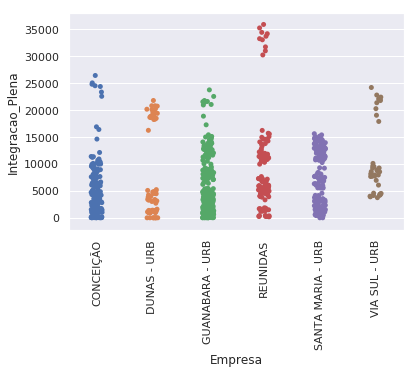

In [0]:
sns.stripplot(x="Empresa", y="Integracao_Plena", data=df, jitter=True)
plt.xticks(rotation=90)
plt.show()

## Violin plot

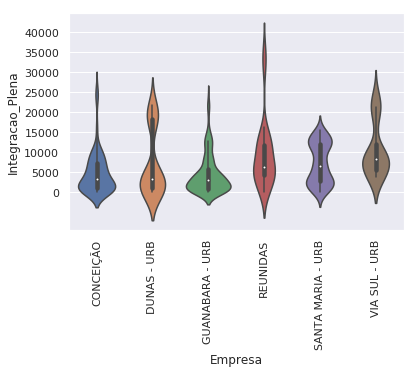

In [0]:
sns.violinplot(x="Empresa", y="Integracao_Plena", data=df)
plt.yticks(range(0,41000,5000))
plt.xticks(rotation=90)
plt.show()

## Correlogram or Scatter plot matrix

[]

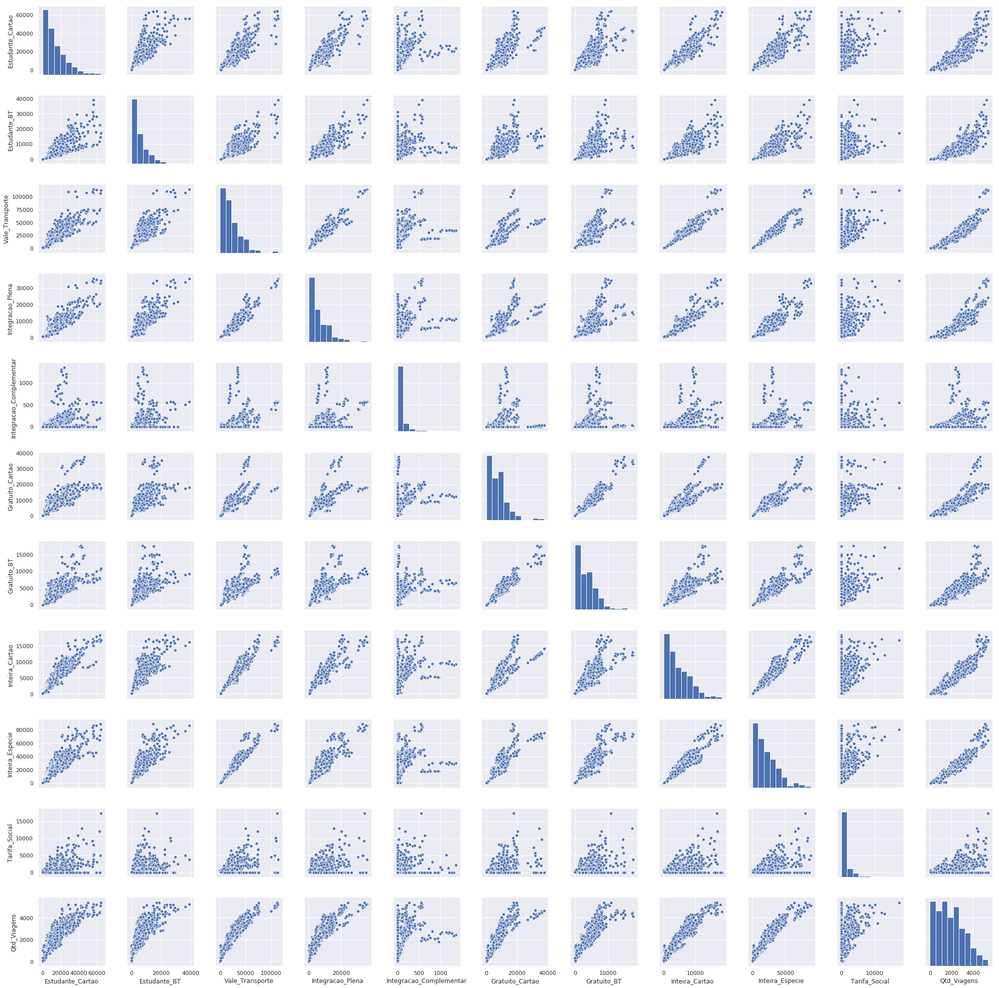

In [0]:
sns.pairplot(df, vars=df.columns[3:])
plt.plot()

## Correlation Matrix

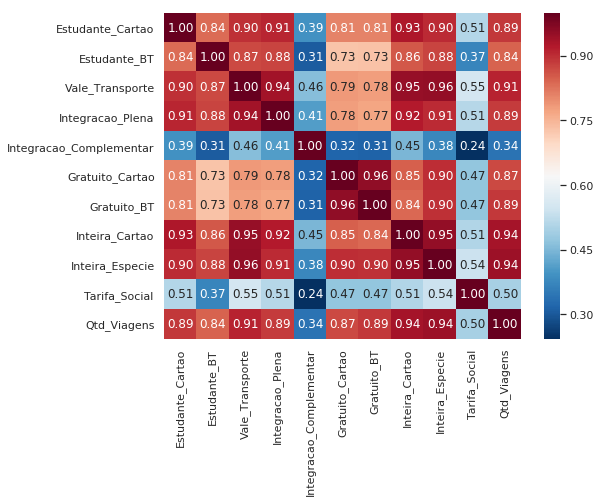

In [0]:
plt.figure(figsize=(8,6))
sns.heatmap(df[df.columns[3:]].corr(), annot=True, fmt=".2f", cmap = "RdBu_r")
plt.show()

#### Exercise

![alt text](https://cdn.dribbble.com/users/2344801/screenshots/4774578/alphatestersanimation2.gif =150x120)

1. Your turn! After learning about plots with seaborn, choose one kind of plot and try to get an amazing insight! What information can you extract from those data?

# Interactive plots with Bokeh

## Introduction

Bokeh is an interactive visualization library that targets modern web browsers for presentation. Its goal is to provide elegant, concise construction of versatile graphics, and to extend this capability with high-performance interactivity over very large or streaming datasets. Bokeh can help anyone who would like to quickly and easily create interactive plots, dashboards, and data applications.

<img src="https://cdn-images-1.medium.com/max/800/1*lJZkxGv5aVGtG_0FtFNc0g.png" />

## Getting started

Firstly, let's install bokeh and check its version:

In [0]:
!pip install bokeh

In [0]:
from bokeh import __version__ as bokeh_version
bokeh_version

'1.0.4'

Let's do some Bokeh basic imports and tell it where generate the output:

In [0]:
from bokeh.io import output_notebook, show
from bokeh.plotting import figure
output_notebook()

Loading BokehJS ...

## Line Plot

In [0]:
output_notebook()

df_grouped = df.groupby(['Mês'], as_index=False).sum()

fig = figure(plot_width=600, plot_height=400, title="Passagens estudantis por mês")
fig.line('Mês', 'Estudante_Cartao', source=df_grouped, line_width=2)

show(fig)

Loading BokehJS ...

In [0]:
output_notebook()

df_by_company = df.groupby(['Empresa','Mês'], as_index=False).sum()
conceicao = df_by_company[df_by_company['Empresa'] == 'CONCEIÇÃO']
reunidas = df_by_company[df_by_company['Empresa'] == 'REUNIDAS']

fig = figure(plot_width=600, plot_height=400, title="Passagens estudantis por mês", x_axis_label="Mês", y_axis_label="Estudante_Cartao")
fig.line('Mês', 'Estudante_Cartao', source=conceicao, line_width=2, line_dash="dotted", line_color="indigo", legend="Conceição")
fig.line('Mês', 'Estudante_Cartao', source=reunidas, line_width=2, line_color="tomato", line_dash="dashed", legend="Reunidas")

output_notebook()
show(fig)

Loading BokehJS ...

Loading BokehJS ...

In [0]:
from bokeh.layouts import row, gridplot

plot_options = dict(width=350, plot_height=250, tools='pan,wheel_zoom')

# create a new plot
s1 = figure(**plot_options)
s1.line('Mês', 'Estudante_Cartao', source=conceicao, color="navy", alpha=0.5)

# create another one
s2 = figure(**plot_options)
s2.line('Mês', 'Estudante_Cartao', source=reunidas, color="firebrick", alpha=0.5)

output_notebook()
# show the results in a row
show(gridplot([[s1, s2]]))

Loading BokehJS ...

## Bar plot

In [0]:
from bokeh.core.properties import value

df_by_company = df.groupby(['Empresa'], as_index=False).sum()
companies = df_by_company['Empresa'].unique()
tickets = ['Inteira_Cartao', 'Inteira_Especie']

fig = figure(plot_width=600, plot_height=400, x_range=companies, tools="hover", tooltips="$name: @$name")

fig.vbar_stack(tickets, x='Empresa', source=df_by_company, width=0.5, color=['#c9d9d3', '#718dbf'], legend=[value(x) for x in tickets])
fig.xaxis.major_label_orientation = 'vertical'

output_notebook()
show(fig)

Loading BokehJS ...

## Strip Plot

In [0]:
from bokeh.layouts import column
from bokeh.transform import jitter

empresas = df['Empresa'].unique()

p1 = figure(plot_width=600, plot_height=300, x_range=empresas, title="Empresas vs Gratuito_Cartao without jittering")
p1.circle(x='Empresa', y='Gratuito_Cartao', size=9, alpha=0.4, source=df)
p1.xaxis.major_label_orientation = 'vertical'

p2 = figure(plot_width=600, plot_height=300, x_range=empresas, title="Years vs mpgEmpresas vs Gratuito_Cartao with jittering")
p2.circle(x=jitter('Empresa', 0.4, range=p2.x_range), y='Gratuito_Cartao', size=9, alpha=0.4, source=df)
p2.xaxis.major_label_orientation = 'vertical'

output_notebook()

show(column(p1, p2))

Loading BokehJS ...

## Hexbin plot

In [0]:
from bokeh.models import HoverTool

(x, y) = (df['Gratuito_Cartao'], df['Estudante_BT'])

# creating and setting the figure
fig = figure(title="Hexbin for Gratuito_Cartao e Estudante_BT", match_aspect=True,
         tools="wheel_zoom,reset", background_fill_color='#440154')

fig.grid.visible = False

r, bins = fig.hexbin(x, y, size=1000, hover_color="pink", hover_alpha=0.8)
fig.circle(x, y, color="white", size=1)

fig.add_tools(HoverTool(
    tooltips=[("count", "@c"), ("(q,r)", "(@q, @r)")],
    mode="mouse", point_policy="follow_mouse", renderers=[r]
))

output_notebook()
show(fig)

Loading BokehJS ...

#### Exercise

![alt text](https://cdn.dribbble.com/users/2344801/screenshots/4774578/alphatestersanimation2.gif =150x120)

1. Your turn! After understanding the Bokeh charts, plot another hexbin chart choosing other two features. Try to modify the appearance of the chart.

# Doing more with Plotly

## Introduction

[Plotly.py](https://plot.ly/d3-js-for-python-and-pandas-charts/) is an interactive, open-source, and browser-based graphing library for Python.

Built on top of [plotly.js](https://github.com/plotly/plotly.js), plotly.py is a high-level, declarative charting library. plotly.js ships with over 30 chart types, including scientific charts, 3D graphs, statistical charts, SVG maps, financial charts, and more.

Plotly.py is MIT Licensed and plotly graphs can be viewed in Jupyter notebooks, standalone HTML files, or hosted online on [plot.ly](https://plot.ly).

<img src="https://cdn-images-1.medium.com/max/800/1*_Dr91ijJb3uchQtuF2eloA.png"/>

## Getting started

Firstly, let's install plotly and check its version:

In [5]:
!pip install plotly --upgrade

# restart runtime!!!!!!!!!

    100% |████████████████████████████████| 35.7MB 783kB/s 
  Found existing installation: plotly 3.6.1
    Uninstalling plotly-3.6.1:
      Successfully uninstalled plotly-3.6.1


In [6]:
from plotly import __version__
__version__

'3.7.1'

Let's do some plotly basic imports:

In [0]:
import plotly.offline as pyo
import plotly.graph_objs as go

Plotly into Google Colab requires custom initialization.

In [0]:

# Cell Configuration for plotly over google colab
# This method pre-populates the outputframe with the configuration that Plotly
# expects and must be executed for every cell which is displaying a Plotly graph.
def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-1.5.1.min.js?noext',
            },
          });
        </script>
        '''))

## Bar and line plots

In [0]:
# basic functions to run on google colab
configure_plotly_browser_state()
pyo.init_notebook_mode(connected=False)

empresas = df['Empresa'].unique()
companies_sum = df.groupby(['Empresa']).sum()

trace1 = go.Scatter(
    x = empresas,
    y = companies_sum['Qtd_Viagens'],
    name = "Quantidade de viagens"
)

trace2 = go.Bar(
    x = empresas,
    y = companies_sum['Estudante_Cartao'],
    name = "Nº de passagens no cartão estudantil"
)

trace3 = go.Bar(
    x = empresas,
    y = companies_sum['Estudante_BT'],
    name = "Nº de passagens no bilhete estudantil"
)

pyo.iplot([trace1, trace2, trace3])

## Scatter Plot

In [0]:
# basic functions to run on google colab
configure_plotly_browser_state()
pyo.init_notebook_mode(connected=False)


trace0 = go.Scatter(
    x= df[df['Empresa'] == 'VIA SUL - URB']['Qtd_Viagens'],
    y= df[df['Empresa'] == 'VIA SUL - URB']['Inteira_Cartao'],
    mode='markers',
    name='Via Sul',
    marker=dict(
        size = 10,
        color = 'rgba(152, 0, 0, .8)',
        line = dict(
            width = 2,
            color = 'rgb(0, 0, 0)'
        )
    )
)
trace1 = go.Scatter(
    x= df[df['Empresa'] == 'DUNAS - URB']['Qtd_Viagens'],
    y= df[df['Empresa'] == 'DUNAS - URB']['Inteira_Cartao'],
    mode='markers',
    name='Dunas',
    marker=dict(
        size = 10,
        color = 'rgba(255, 182, 193, .9)',
        line = dict(
            width = 2,
        )
    )
)

trace2 = go.Scatter(
    x= df[df['Empresa'] == 'CONCEIÇÃO']['Qtd_Viagens'],
    y= df[df['Empresa'] == 'CONCEIÇÃO']['Inteira_Cartao'],
    mode='markers',
    name='Conceição',
    marker=dict(
        size = 10,
        color = 'rgba(255, 200, 50, .9)',
        line = dict(
            width = 2,
        )
    )
)

data = [trace0, trace1, trace2]

layout = dict(
    title = 'Styled Scatter',
    yaxis = dict(title='Nº de passagens inteiras (cartão)', zeroline = False),
    xaxis = dict(title='Quantidade de viagens', zeroline = False)
)

fig = dict(data=data, layout=layout)
pyo.iplot(fig)

## 2D Density Plots

In [0]:
import plotly.figure_factory as ff

# basic functions to run on google colab
configure_plotly_browser_state()
pyo.init_notebook_mode(connected=False)

colorscale = ['#7A4579', '#D56073', 'rgb(236,158,105)', (1, 1, 0.2), (0.98,0.98,0.98)]

fig = ff.create_2d_density(
    df['Estudante_BT'], df['Inteira_Cartao'], colorscale=colorscale,
    hist_color='rgb(255, 237, 222)', point_size=3
)

pyo.iplot(fig, filename='histogram_subplots')

## Distplot

In [25]:
import plotly.figure_factory as ff

# basic functions to run on google colab
configure_plotly_browser_state()
pyo.init_notebook_mode(connected=False)

columns = ['Estudante_BT', 'Gratuito_Cartao', 'Qtd_Viagens']

# Create distplot with custom bin_size
fig = ff.create_distplot([df[c].tolist() for c in columns], columns, bin_size=800)

# Plot!
pyo.iplot(fig, filename='Distplot with Multiple Features')

## Radar plot

In [0]:
# basic functions to run on google colab
configure_plotly_browser_state()
pyo.init_notebook_mode(connected=False)

empresas = df['Empresa'].unique()
tickets = df.columns[3:]

data  = []
index = 1
for emp in empresas:
  data.append(
        go.Scatterpolar(
            r = df.loc[df['Empresa'] == emp][tickets].sum(),
            theta = tickets,
            fill = 'toself',
            name = emp,
            subplot = "polar" + str(index)
       )
    )
  index += 1
    
layout = go.Layout(
    title = 'Tickets grid in the companies',
    polar1 = dict(
        domain = dict(
            x = [0, .2],
            y = [0, .4]
        ),
        radialaxis = dict(
            visible = True,
            range=[0, 7000000]
        )
    ),
    polar2 = dict(
        domain = dict(
            x = [0, .2],
            y = [.6, 1]
        ),
        radialaxis = dict(
            visible = True,
            range=[0, 7000000]
        )
    ),
    polar3 = dict(
        domain = dict(
            x = [.4, .6],
            y = [0, .4]
        ),
        radialaxis = dict(
            visible = True,
            range=[0, 7000000]
        )
    ),
    polar4 = dict(
        domain = dict(
            x = [.4, .6],
            y = [.6, 1]
        ),
        radialaxis = dict(
            visible = True,
            range=[0, 7000000]
        )
    ),
    polar5 = dict(
        domain = dict(
            x = [.8, 1],
            y = [0, .4]
        ),
        radialaxis = dict(
            visible = True,
            range=[0, 7000000]
        )
    ),
    polar6 = dict(
        domain = dict(
            x = [.8, 1],
            y = [.6, 1]
        ),
        radialaxis = dict(
            visible = True,
            range=[0, 7000000]
        )
    )
)

fig = go.Figure(data=data, layout=layout)
pyo.iplot(fig)

#### Challenge

![alt text](https://cdn.dribbble.com/users/2344801/screenshots/4774578/alphatestersanimation2.gif =150x120)

1. Try to overlay all the radar plots of the previous example to obtain just one chart with the six plots.